<div class="alert alert-block alert-success">
<b>Objectives:</b> In this practical we will use the GeoPandas package to load data from files and visualise our results on a map. We will introduce the concepts of both raster and vector data, and how these underline the approach of <b>Geographic Information Systems, or GIS</b>. To do this we will open and manipulate datafiles that contains information on bedrock, quarries and flooding risk across the UK. We will do this through the following activities:
    
 - 1) [Introduction: Raster vs. Vector Data in Environmental Science](#Part1)
      * [Exercise 1: Create a map showing locations with only limestone bedrock](#Exercise1)
 - 2) [Adding vector point data and combining GeoPandas dataframes](#Part2)
      * [Exercise 2: Plot the distribution of bedrock under collieries across the UK](#Exercise4)
      * [Exercise 3: Create a map of colliery location and underlying bedrock in Greater Manchester](#Exercise5)
      * [Exercise 4: Plot the location of flood risk zones across Greater Manchester](#Exercise5)
 - 3) [Calculating distances between points and polygons](#Part3)
      * [Exercise 5: Create a map of flooding and substation risk for the Stockport District](#Exercise6)

As with our other notebooks, we will provide you with a template for plotting the results. Also please note that you should not feel pressured to complete every exercise in class. These practicals are designed for you to take outside of class and continue working on them. Proposed solutions to all exercises can be found in the 'Solutions' folder.

Please do not worry about trying to remember all of the syntax in the code we provide. As noted in the lectures, this course is aimed at building experience in using Python and many of its features. Even seasoned professionals have to look up solutions from old files or online! 
</div>


<div class="alert alert-block alert-danger">
<b> Using Google Colabs </b> Please note that the first code block ensures that we can access our files IF we are running this example on Google Colab. Please run this code block and, if you are not on Google Colab, you will recieve a message that confirms this. 
</div>

In [1]:
if 'google.colab' in str(get_ipython()):
    !pip install contextily
else:
     print('Not running on CoLab')

if 'google.colab' in str(get_ipython()):
    from google.colab import drive
    mount='/content/gdrive'
    print("Colab: mounting Google drive on ", mount)
    drive.mount(mount)
    drive_root = mount + "/My Drive/Colab Notebooks/DEES_first_year/DEES_programming_course"
    # Change to the directories to get data files
    print("\nColab: Changing directory to ", drive_root)
    %cd $drive_root
else:
    print('Not running on CoLab')

Not running on CoLab


# 1) Introduction: Raster vs. Vector Data in Environmental Science  <a name="Part1">

In the previous notebook we worked with geospatial data in the form of coordinates of volcanic eruptions. This gave us an opportunity to introduce the Pandas dataframe functionality within Python. We also used the module `Cartopy` for plotting said data on a map, thus creating a useful visualisation of data that could be used to build expert analysis, or learning, around. In most areas of environmental science spatial data is pivotal for analysis and visualization; So much so that it is useful we briefly extend our geospatial learning to include more *formal* definitions of processes and data types. 

If you start to work more frequently with geospatial data, you will inevitably come across **Geographic Information Systems**, or more commonly referred to as **GIS**. GIS is a system used for capturing, storing, checking, and displaying data related to positions on Earth's surface. It helps analysts understand patterns, relationships, and geographic context. In our course so far we have structured our learning around types of data storage and ways to create and access data. When we refer to GIS we might consider this a seperate field by itself. Indeed, there are multiple components of GIS:

- **Data**: The core of GIS, encompassing geographical (spatial) data and attribute (descriptive) data.
- **Tools for Analysis**: GIS provides tools to analyze and interpret data, revealing patterns and relationships.
- **Visualization**: Beyond maps, GIS allows for sophisticated visual representations like 3D models and thematic maps.

How is this different from what we have looked at so far? GIS essentially is a system for:

- **Layering Information**: GIS layers different types of data (like roads, rivers, population) to show relationships and patterns.
- **Spatial Analysis**: It can perform complex spatial analyses, answering questions like "What is the shortest route?" or "What areas are at high risk for flooding?"

GIS is often, and incorrectly, thought to remain a tool solely within the field of Geography. GIS is not just for geographers; it's used in history, archaeology, environmental science, engineering, and more. Many use dedicated GIS software products to perform the above. The most common include: 

- **ArcGIS**: Developed by Esri, ArcGIS is one of the most widely used GIS software tools globally. It offers a suite of professional GIS applications, including ArcMap, ArcGIS Pro, and various online tools. It's known for its extensive capabilities in data visualization, analysis, and management.
- **QGIS (Quantum GIS)**: An open-source alternative to ArcGIS, QGIS is highly popular among users who prefer open-source. It offers a  set of features for mapping and spatial analysis. Its compatibility with various file formats and extensible nature through plugins makes it a versatile choice.
- **Google Earth Engine**: An advanced cloud-based tool for planetary-scale environmental data analysis. It's known for its massive archive of satellite imagery and geospatial datasets, which are useful for large-scale environmental monitoring and analysis.
- **....**

Tools vary widely in functionality, complexity, and cost, catering to different needs and skill levels. In this notebook we will find that there are modules, thus tools, in Python that can perform the aforementioned GIS functionality of layering through to spatial analysis. However we need to add new formal defintions to the core of GIS, the underlying data, before we begin. 

## Raster and Vector Data

Geospatial data primarily comes in two forms: **raster** and **vector** data. Understanding their differences, applications, and formats is important in the field. 

<center>
<img src="images/featured3.png" alt="Alternative text" width="800" height="800"/> 
</center>


### Raster Data

Raster data represents the Earth's surface as a matrix of cells, with each cell holding a value to represent a certain attribute like temperature or elevation. You can think of this as a chekcerboard placed over the ground, where there is a value in each cell of the board. This may represent any variable of interest such as temperature, soil moisture, height and so on. The left hand side of figure 1 illustrates this concept. We can imagine opening a raster dataset in a wide range of software products, including Excel if we really wanted to.

### Vector Data

Vector data uses geometric shapes (points, lines, polygons) to represent spatial features like locations (wells, weather stations), paths (rivers, roads), and areas (lakes, political boundaries). We have already encoutered points in the previous notebook. Coordinates of single locations as a function of time resemble a raster dataset. 

Key characteristics and examples of both **raster** and **vector** data are given in the table below. You can also find common formats used for storing the data. That isnt to say we will stop using CSV files. However, we quickly find that CSV files are rather limited when we start to work with data that is more complex than tabular structures. CSV files are also relatively inefficient so larger quantities of data require bespoke formats. We have already noted that Pandas can work with a wide range of data formats. For example, JSON stands for JavaScript Object Notation. It is a lightweight data-interchange format that is easy for humans to read and write, and easy for machines to parse and generate. 


If you were to open a GEOJSON file in a text editor you might find something similar to the following example containing a single point feature:

```json
{
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "geometry": {
        "type": "Point",
        "coordinates": [-73.9617, 40.6629]
      },
      "properties": {
        "name": "Brooklyn",
        "borough": "Kings",
        "state": "NY"
      }
    }
  ]
}
```

In this example, the GeoJSON object is a FeatureCollection. It contains an array of Feature objects. Each Feature has a geometry (in this case, a Point with coordinates) and properties (additional data about the feature). GeoJSON introduces specific types such as Point, LineString, Polygon, MultiPoint, MultiLineString, MultiPolygon, and GeometryCollection. Each of these types is used to represent different types of geographical features. We will be working with SHP files [see table below - Shapefiles] in this notebook. I cant actually provide you with an example of a SHP file per the GeoJOSN file. Shapefiles consist of several files that work together, and they contain binary data which is not human-readable in the same way.  They are however much more efficient in terms of storage requirements. The Shapefile format, commonly known as .shp, was created by Esri (Environmental Systems Research Institute), a leading company in the field of geographic information systems (GIS). Esri developed the Shapefile format in the early 1990s for their GIS software, and it quickly became a popular format for storing geographical data due to its simplicity and ease of use. 


| Data Type | Key Characteristics                                                                 | Common Formats                                  | Examples                                             |
|-----------|-------------------------------------------------------------------------------------|-------------------------------------------------|-----------------------------------------------------|
| Raster    | - Grid format (rows and columns) <br> - Cell values for attributes <br> - Resolution dependent | - GeoTIFF (.tif) <br> - ERDAS IMAGINE (.img) <br> - Digital Elevation Models (DEM) | - Satellite imagery <br> - Elevation data (DEMs) <br> - Land cover maps |
| Vector    | - Shape-based (points, lines, polygons) <br> - Precise location <br> - Attribute richness | - Shapefile (.shp) <br> - GeoJSON (.geojson) / TopoJSON (.topojson) <br> - KML/KMZ (.kml/.kmz) | - Map of geological sample locations <br> - River network diagrams <br> - Boundary maps for geological formations |

You may well ask what category our coordinate data from the previous notebook would fall within. That would be classed as *point vector* data since it was not provided under a fixed grid, but rather a set of latitude and longitude values for each eruption. In this notebook we will also work with polygon and line vector data. Choosing between raster and vector data depends on the data's nature and the analysis requirements. 

- **Analysis type**: Some analyses favor the continuous nature of raster data; others need the precision of vector data.
- **Data integration**: Often, integrating both raster and vector data is necessary.
- **Visualization**: Raster and vector formats differ significantly in mapping and visualization.

Understanding raster and vector data's differences, along with their specific formats, is essential for geoscientists to effectively analyze, integrate, and visualize spatial information.

One more point of discussion before we begin..

A slight *tweak* to Pandas is required to deal with line and polygon vector data. The good news is that someone has already done this for us. A module called GeoPandas is built exactly to deal with line and polygon data. 

## What is GeoPandas?

GeoPandas is an open-source project that makes working with geospatial data in Python easier. It extends the datatypes used by pandas to allow spatial operations on geometric types. Geometric operations are performed by `shapely`. GeoPandas further depends on `fiona` for file access and `matplotlib` for plotting. These are all modules that are installed when we install GeoPandas using the `conda` package manager. Figure xx below provides a simple illustration of GeoPandas. Features of GeoPandas include:

- **Geospatial Data Handling**: Simplifies handling of geospatial data (like shapefiles, GeoJSON) in Python.
- **Integration with pandas**: Builds upon and extends pandas, making it easy to work with geospatial data using familiar pandas functionalities.
- **Geometry Operations**: Enables geometry operations (like calculating area, distance, buffering) directly on GeoDataFrame.
- **Plotting and Visualization**: Offers straightforward plotting of geospatial data, which integrates well with `matplotlib`.

The GeoDataFrame is the core data structure in GeoPandas, which can store geometry columns and perform spatial operations.

<center>
<img src="images/geopandas.png" alt="Alternative text" width="500" height="500"/> 
</center>

notice how we still retain the concept of an index, but have a seperate column that can store shapes. We will load a `.shp` file that contains information on bedrock geology across the UK. First we will import relevant modules that we will use across this notebook. These are:

 - GeoPandas
 - Contextily [a small Python 3 (3.7 and above) package to retrieve tile maps from the internet](https://contextily.readthedocs.io/en/latest/). It can add those tiles as a basemap to matplotlib figures, which gives us the underlying map.
 - Matplotlib. As usual...this deals with all of our plotting requirements.

In [2]:
# import the modules, using standard naming convention.
import geopandas as gpd
import contextily as cx
import matplotlib.pyplot as plt
%matplotlib inline
import os
from os import path

path=os.getcwd()

# Our file has the following path and name - notice the extension .shp
file = path+"/data/digmap625_bedrock_arc/625k_V5_BEDROCK_Geology_Polygons.shp"
# Like Pandas, GeoPandas has a read_file function. Im creating a GeoDataframe called 'gdf'
gdf = gpd.read_file(file)

# Preview the GeoDataframe to the screen
gdf

,LEX,LEX_D,LEX_RCS,RCS,RCS_X,RCS_D,RANK,BED_EQ,BED_EQ_D,MB_EQ,...,BGSREF_GP,BGSREF_RK,SHEET,VERSION,RELEASED,NOM_SCALE,NOM_OS_YR,NOM_BGS_YR,MSLINK,geometry
0,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((274375.248 555042.401, 274315.421 55..."
1,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((273618.809 553462.498, 273661.625 55..."
2,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((270985.247 554515.841, 270985.247 55..."
3,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((273409.542 555538.671, 273361.680 55..."
4,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((271835.801 556443.700, 271770.116 55..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11239,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((633760.875 140660.672, 633059.688 13..."
11240,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((577986.813 169677.828, 577981.250 16..."
11241,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((561716.396 179667.794, 561910.362 17..."
11242,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((585387.000 346343.938, 585321.000 34..."


Notice how GeoPandas, like Pandas, has created its own indexing system of assigning a number to each row. There are also mulitple columns. Unfortunately you will often find it is difficult to obtain 'meta data' associated with records. Meta-data provides us with important information, such as when data was collected and so on. In this instance, I want to create a map using the column **RCS_D** which describes the dominant type of rock. To place this on a map, I need coordinates.  If you scroll to the right hand edge if the dataframe you will find a column called `geometry`. This contains `POLYGON` with what appear to be a series of floating point numbers. This brings us on to an important check-point; Coordinate Reference Systems. 

## Coordinate Reference System (CRS) 

Before we create our map using the information provided in this file, we need to check what system is being used to represent the coordinates. If you take a look at the column `geometry` we can clearly see these do not represent latitude and longitude numbers. But why? A Coordinate Reference System (CRS) defines how the two-dimensional, projected map in your GeoDataFrame relates to real places on the earth. CRS can be represented in various formats, such as EPSG codes. EPSG codes are short identifiers assigned to coordinate reference system (CRS) definitions. These codes are standardized and maintained by the EPSG (European Petroleum Survey Group) Geodetic Parameter Dataset. EPSG codes cover both geographic coordinate systems (GCS) and projected coordinate systems (PCS). A GCS uses latitude and longitude to define locations on the earth's surface, while a PCS provides a flat, two-dimensional representation of the earth.

The following table lists some of the most frequently used EPSG codes in GIS, along with their descriptions:

| EPSG Code | CRS Name                   | Description                                                                                   |
|-----------|----------------------------|-----------------------------------------------------------------------------------------------|
| EPSG:4326 | WGS 84                     | Standard for global geographic coordinate system, used in GPS and for global datasets.        |
| EPSG:3857 | WGS 84 / Pseudo-Mercator   | Also known as Web Mercator. Common for web mapping services like Google Maps and OpenStreetMap. |

**Key Points**:
- **EPSG:4326** is widely used for datasets that span the entire globe. It represents coordinates in latitude and longitude.
- **EPSG:3857** is used for displaying maps on web applications, offering a compromise between a spherical and flat representation of the earth.
- ...
- **Using EPSG codes ensures that spatial data from different sources can be combined and analyzed accurately. Correct CRS selection (via EPSG codes) is crucial for accurate distance and area measurements, especially over large geographic extents. This is crucial when combining data from different sources to ensure they align correctly.**

So we need to check what Coordinate Reference System (CRS) our bedrock datafile is in. To do this, we can use the ```python .crs ``` property of our GeoDataframe as per the code box below.

In [3]:
gdf.crs

<Projected CRS: PROJCS["OSGB36 / British National Grid",GEOGCS["OS ...>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

We are told this data is stored using a projected coordinate system. More specifically, OSGB36. OSGB36 was historically developed to provide a consistent and accurate mapping framework for the UK.  For applications that require global positioning, such as GPS, data from OSGB36 often needs to be transformed to a more universally recognized datum like EPSG:4326. We are going to convert all of our loaded vector and raster files into EPSG:3857. As we combine data from different sources, we need to ensure they are based on the same CRS. Fortunately, GeoPandas allows us to move between different systems. In the code snippet below, we create reference to a new GeoDataframe using the `.to_crs` function. We also preview it and notice that data in the geometry column has indeed changed.

In [4]:
gdf_wm = gdf.to_crs(epsg=3857)
gdf_wm

,LEX,LEX_D,LEX_RCS,RCS,RCS_X,RCS_D,RANK,BED_EQ,BED_EQ_D,MB_EQ,...,BGSREF_GP,BGSREF_RK,SHEET,VERSION,RELEASED,NOM_SCALE,NOM_OS_YR,NOM_BGS_YR,MSLINK,geometry
0,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((-440750.842 7337513.465, -440854.565..."
1,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((-441985.281 7334731.896, -441909.793..."
2,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((-446601.788 7336431.621, -446599.179..."
3,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((-442449.345 7338328.683, -442532.332..."
4,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",UISD-MFIR,MFIR,MFIR,MAFIC IGNEOUS-ROCK,INTRUSION,UISD,"UNNAMED IGNEOUS INTRUSION, LATE SILURIAN TO EA...",NoPar,...,773,773,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,18166,"POLYGON ((-445222.788 7339823.915, -445336.698..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11239,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((149030.968 6642109.528, 147869.541 6..."
11240,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((62031.488 6692037.027, 62020.676 669..."
11241,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((36526.794 6708936.970, 36820.807 670..."
11242,WHCK,WHITE CHALK SUBGROUP,WHCK-CHLK,CHLK,CHLK,CHALK,SUBGROUP,NotAp,Not Applicable,NotAp,...,420,430,625k_V5_Bedrock,5.17,11- 2-2008,625000,2005 HC,2007,17472,"POLYGON ((84610.507 6979741.094, 84499.792 697..."


Now we are close to producing our first map. GeoDataframes have a `.plot` function, like Pandas dataframes. By defauly they will plot the information stored within the geometry column. In the following short code snippet there are multiple operations and options provided. Lets break them down a little to try and understand a little more.

<div class="alert alert-block alert-info">
    
 - Create reference to a new axis, 'ax1', which is created when calling the `.plot` function. A number of plot options and arguments are provided. This include:
 > alpha - a level of transpareny for the bedrock layers. I would like to see some of the underlying map
 > column - specify the column by which I want to classify the different polygons, thus label.
 > edgecolor - colour to seperate the polygons
 > cmap - the colour scheme to use for the different categories. There are many in Matplotlib: [https://matplotlib.org/stable/users/explain/colors/colormaps.html]
 > legend - do I want a legend? Yes.
 > legend_kwds - these are specific keywords that define the style and placing of the legend, which you do not need to remember!
    
 - Use contextily to add a basemap to the above axis. Contextily works by providing different styles of tiles to our figures. The default is to use OpenStreetMap, which looks like Google Maps. When we call the function `.add_basemap` we have to tell Contextily which axis to use, and the CRS system to map on to. It does all ofthe alignment for us! Note this is a web service so if not connected to the internet this may not work.

</div>

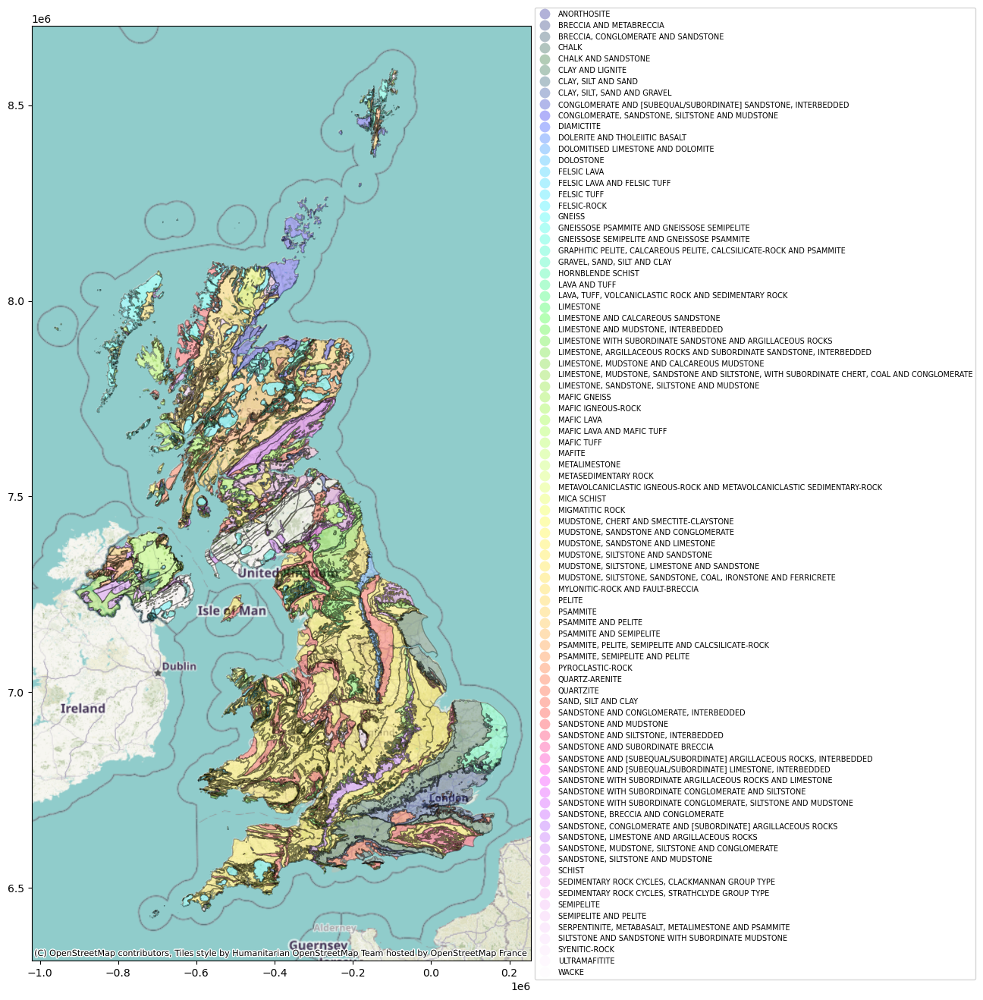

In [5]:
# Create an axis [ax1] that has the information held within the gdf_wm dataframe. Provide styling and colouring option
ax1 = gdf_wm.plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar",legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
# Use the Contextily module to add a basemap underneath axes (ax1), which will look like OpenStreetMap. We make sure Contextily uses the same 'CRS' system by supplying this as an argument
cx.add_basemap(ax1, crs='EPSG:3857')

## Selecting a subset of data. 

In our previous notebook we were able to select a subset of a dataframe. For example, we only wanted to plot data from eruptions that occured in 2019. To do this we created a reduced dataframe created by the following code:

```python
data[data['Start Year'] == 2019]
```

I dont have any specific numeric criteria in this example. Rather, I want to select a subset according to the enries in the column **RCS_D**. The `.str.contains()` function in Pandas (and by extension, GeoPandas, since GeoPandas is an extension of Pandas) is used to check if each string in a Series or Index contains a specified pattern or substring. It's commonly used for filtering data based on string patterns. In our case, this means I can select a subset of our dataframe that has certain keywords. In the example below, I recreate the above map but only for entries that contain 'SANDSTONE' in the column **RCS_D**. Note that I first create a new GeoDataframe called `gdf_wm_new` based on this criteria. 

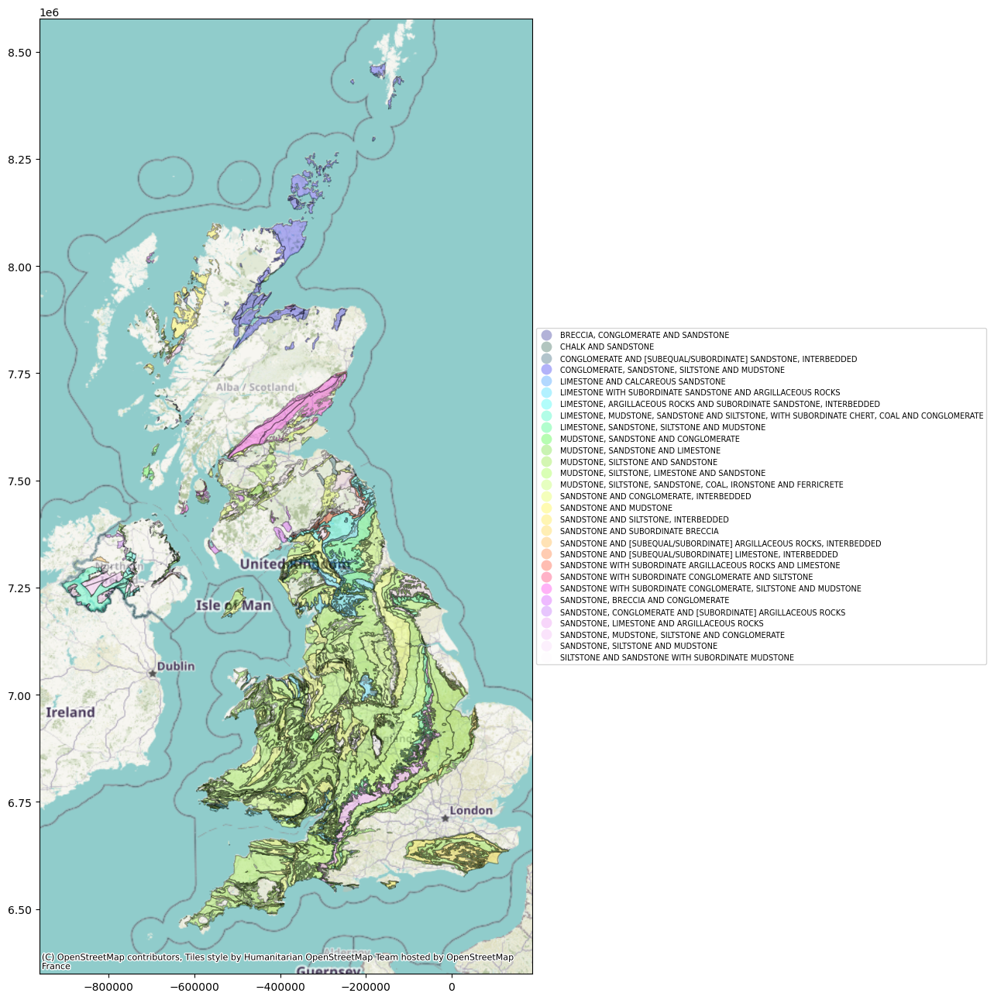

In [6]:
gdf_wm_new = gdf_wm[gdf_wm["RCS_D"].str.contains('SANDSTONE')]
ax2 = gdf_wm_new.plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar",legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
cx.add_basemap(ax2, crs='EPSG:3857')

<div class="alert alert-block alert-success">
<b> Exercise 1: Create a map showing locations with only limestone bedrock. <a name="Exercise1"></a>  </b> Repeat the above code demonstration but selecting only locations with limestone deposits. I have chosen the name of a new dataframe for you.
</div>

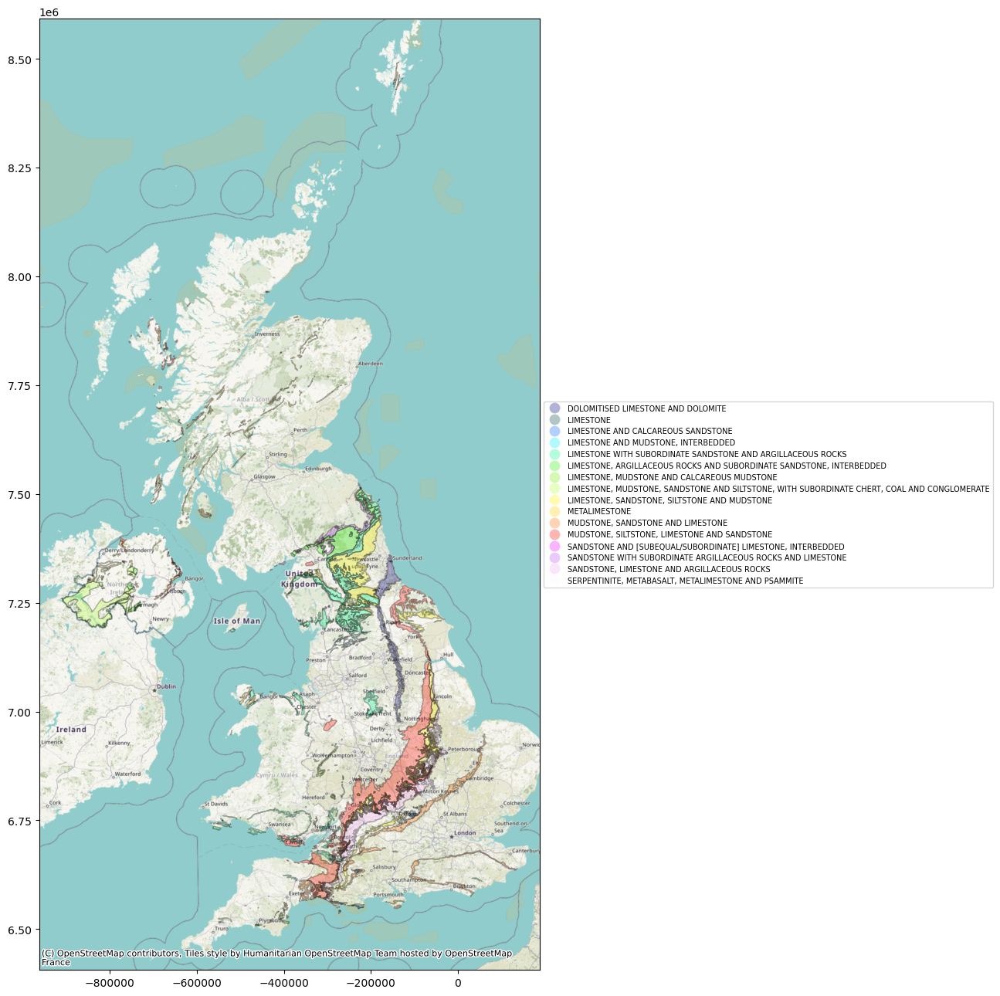

In [7]:
# -------'INSERT CODE HERE'-------
gdf_wm_ex1 = gdf_wm[gdf_wm["RCS_D"].str.contains('LIMESTONE')]
ax3 = gdf_wm_ex1.plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar",legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
cx.add_basemap(ax3, crs='EPSG:3857')
# --------------------------------

# 2) Adding vector point data and combining GeoPandas dataframes   <a name="Part2">

## Adding vector point data

We now want to add a new layer to our map. GIS systems are built to add layers. To demonstrate this I obtained a Shapefile containing information on the location of Collieries across the UK, from the [National Library of Scotland](https://data.nls.uk/projects/mapping-quarries-and-collieries/) as poart of their [GB1900 gazetteer project](https://data.nls.uk/data/map-spatial-data/gb1900/). A colliery refers to a coal mine and its associated buildings, where coal is extracted from underground. In the context of a colliery, the term encompasses not only the physical mine shafts but also the infrastructure and facilities used for the extraction and processing of coal. The type of bedrock underlying a colliery can vary significantly depending on the geological characteristics of the region where the coal mine is located. Coal is formed from the remains of ancient plants and animals that accumulated in swampy environments millions of years ago, eventually becoming buried under layers of sediment. Over time, these organic deposits were subjected to high pressure and heat, transforming into coal. 
Our task is to use GeoPandas to plot these locations over our existing bedrock map. First we need to load this new Shapefile.

In [8]:
# make referene to the location of the .shp file and then use GeoPandas to load in and then preview.
file_colliery = path+"/data/collieries/collieries.shp"
cdf = gpd.read_file(file_colliery)
cdf

,pin_id,final_text,nation,local_auth,parish,osgb_east,osgb_north,latitude,longitude,notes,field_11,field_12,field_13,field_14,field_15,geometry
0,582454ab2c66dc2d42047bf8,Witley Colliery,England,Dudley,Dudley (Un-parished),395255.499466851,283988.832690251,52.453832,-2.071245,None,None,None,None,None,None,POINT (-2.07124 52.45383)
1,57fe3a562c66dcab3d04f7db,Victoria Colliery,England,Sandwell,Sandwell (Un-parished),400105.421757637,290519.531861927,52.512565,-1.999876,None,None,None,None,None,None,POINT (-1.99988 52.51256)
2,57fe3a642c66dcab3d04f7e5,Lyttleton Colliery,England,Sandwell,Sandwell (Un-parished),400022.412780917,290345.942248252,52.511004,-2.001100,None,None,None,None,None,None,POINT (-2.00110 52.51100)
3,57fe3a722c66dcab3d04f7eb,Spon Lane Colliery (Disused),England,Sandwell,Sandwell (Un-parished),400217.558344745,290229.001480458,52.509953,-1.998224,None,None,None,None,None,None,POINT (-1.99822 52.50995)
4,5825f9d12c66dcdc11007260,Blakeley Hall Colliery (Disused),England,Sandwell,Sandwell (Un-parished),399943.744828866,289538.92252543,52.503749,-2.002258,None,None,None,None,None,None,POINT (-2.00226 52.50375)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3087,594faefd2c66dc085a0d76ce,Newburgh Colliery,England,Northumberland,Togston,427939.990589279,601906.602330113,55.310459,-1.561376,None,None,None,None,None,None,POINT (-1.56138 55.31046)
3088,58938e582c66dc811903b8bd,Ulgham Grange Colliery (Disused),England,Northumberland,Ellington,425143.83493279,592681.144276922,55.227714,-1.606246,None,None,None,None,None,None,POINT (-1.60625 55.22771)
3089,594fd6532c66dc085a0d867d,Brayton Domain Colliery (Pit No. 3),England,Allerdale,Aspatria,315962.935197955,541424.878137047,54.760702,-3.307486,None,None,None,None,None,None,POINT (-3.30749 54.76070)
3090,58fbaa5c2c66dcf8fa0fdc7a,Allhallows Colliery,England,Allerdale,Allhallows,320260.067142663,542352.390708652,54.769736,-3.240980,None,None,None,None,None,None,POINT (-3.24098 54.76974)


Once again we have a **geomtry** column. However, now it is called a **POINT** rather than polygon. If we want to plot these points on our map, we again need to check the CRS system (Coordinate Reference System) used. If it dosnt match, we will need to convert. Lets again use the `.crs` function.

In [9]:
cdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

So we need to convert to the same EPSG number of 3857. Once again I create a new dataframe to do this as per below, and then preview it.

In [10]:
cdf_wm = cdf.to_crs(epsg=3857)

In [11]:
cdf_wm

,pin_id,final_text,nation,local_auth,parish,osgb_east,osgb_north,latitude,longitude,notes,field_11,field_12,field_13,field_14,field_15,geometry
0,582454ab2c66dc2d42047bf8,Witley Colliery,England,Dudley,Dudley (Un-parished),395255.499466851,283988.832690251,52.453832,-2.071245,None,None,None,None,None,None,POINT (-230569.907 6882603.812)
1,57fe3a562c66dcab3d04f7db,Victoria Colliery,England,Sandwell,Sandwell (Un-parished),400105.421757637,290519.531861927,52.512565,-1.999876,None,None,None,None,None,None,POINT (-222625.234 6893339.631)
2,57fe3a642c66dcab3d04f7e5,Lyttleton Colliery,England,Sandwell,Sandwell (Un-parished),400022.412780917,290345.942248252,52.511004,-2.001100,None,None,None,None,None,None,POINT (-222761.387 6893054.187)
3,57fe3a722c66dcab3d04f7eb,Spon Lane Colliery (Disused),England,Sandwell,Sandwell (Un-parished),400217.558344745,290229.001480458,52.509953,-1.998224,None,None,None,None,None,None,POINT (-222441.307 6892861.900)
4,5825f9d12c66dcdc11007260,Blakeley Hall Colliery (Disused),England,Sandwell,Sandwell (Un-parished),399943.744828866,289538.92252543,52.503749,-2.002258,None,None,None,None,None,None,POINT (-222890.374 6891727.288)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3087,594faefd2c66dc085a0d76ce,Newburgh Colliery,England,Northumberland,Togston,427939.990589279,601906.602330113,55.310459,-1.561376,None,None,None,None,None,None,POINT (-173811.591 7422354.571)
3088,58938e582c66dc811903b8bd,Ulgham Grange Colliery (Disused),England,Northumberland,Ellington,425143.83493279,592681.144276922,55.227714,-1.606246,None,None,None,None,None,None,POINT (-178806.513 7406186.706)
3089,594fd6532c66dc085a0d867d,Brayton Domain Colliery (Pit No. 3),England,Allerdale,Aspatria,315962.935197955,541424.878137047,54.760702,-3.307486,None,None,None,None,None,None,POINT (-368187.611 7315561.055)
3090,58fbaa5c2c66dcf8fa0fdc7a,Allhallows Colliery,England,Allerdale,Allhallows,320260.067142663,542352.390708652,54.769736,-3.240980,None,None,None,None,None,None,POINT (-360784.207 7317304.297)


How do we add this new data on to our existing map? Recall in the first map exercise we created a new axis, **ax1**. This axis provides a canvas on which we can add datapoints. Indeed, we have already found that a dataframe as a `.plot` function. Using this function we can also specify which axis to plot on. Take a look at the new second line in the code snippet below. This looks very much like our previous Matplotlib plot functions. We also still end by using `Contextily` to add a basemap, ensuring we use the correct EPSG code.

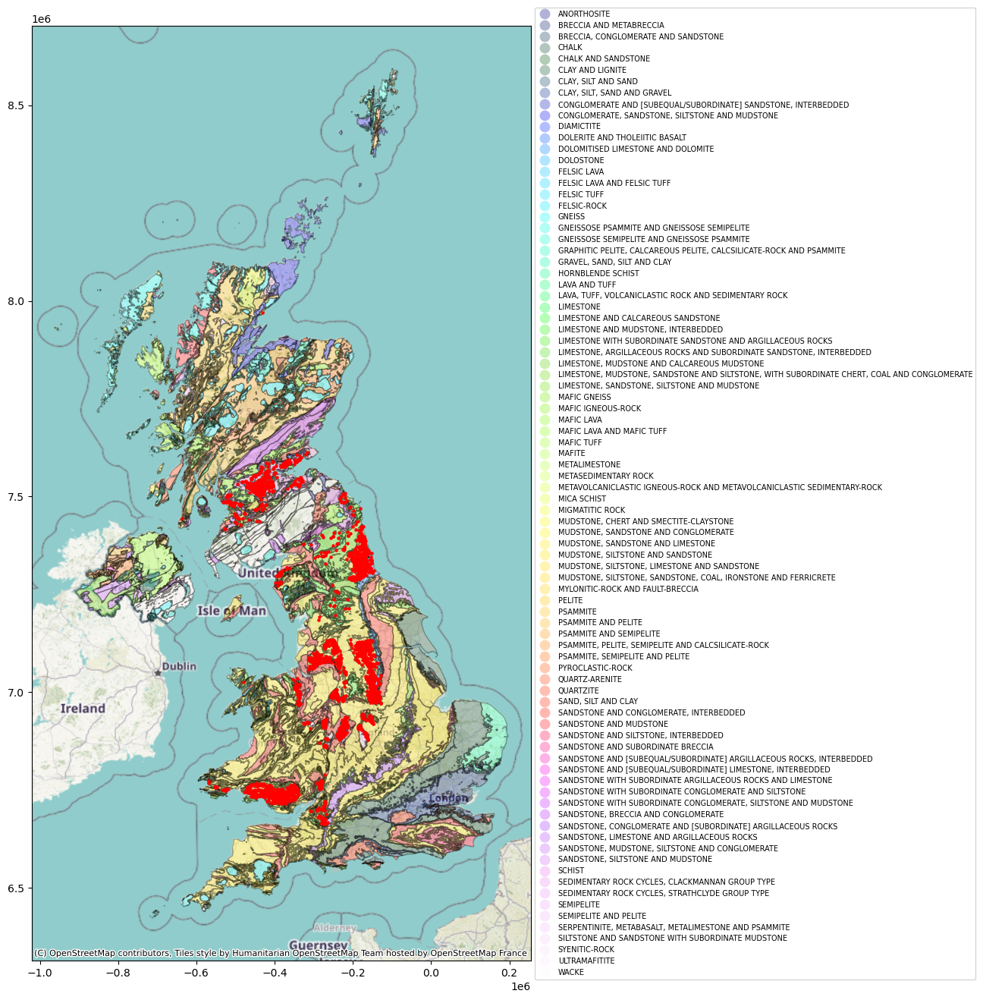

In [12]:
# Create a new axis for our bedrock map, using the same options as before.
ax1_new = gdf_wm.plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar", legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
# Now plot data from our new colliery dataframr, cdf_wm, specifying the axis to host the datapoints.
cdf_wm.plot(ax=ax1_new, marker='o', color='red', markersize=5)
# Use contextily to add a basemap.
cx.add_basemap(ax1_new, crs='EPSG:3857')

Great. Now I want to create a map where only the bedrocl and colliery location overlap. This is too complex to perform manually using a subset search. Fortunately we can join two different GeoDataframes and it will only overlap data where the geomtetry aligns.  We are going to join Pandas dataframes based on time information in a later practical, but we need overlapping geometries. 

## Join and Clip GeoPandas dataframes

The `.sjoin` (spatial join) function in GeoPandas is a tool for combining two GeoDataFrames based on their spatial relationship. It's akin to a standard join in Pandas, but instead of joining on keys, it joins based on spatial relationships between the geometries (like points, lines, polygons) in the GeoDataFrames. Take a look at the following code snippet. In the first line we create a new dataframe `joined_df` by combining the bedrock and colliery dataframes, before previewing it.

In [13]:
# Spatial join
joined_df = gpd.sjoin(gdf_wm, cdf_wm)
joined_df

,LEX,LEX_D,LEX_RCS,RCS,RCS_X,RCS_D,RANK,BED_EQ,BED_EQ_D,MB_EQ,...,osgb_east,osgb_north,latitude,longitude,notes,field_11,field_12,field_13,field_14,field_15
368,PSMCM,PENNINE MIDDLE COAL MEASURES FORMATION AND SOU...,PSMCM-MSCI,MSCI,COAL + FECRTE + FEST + MDST + SDST + SLST,"MUDSTONE, SILTSTONE, SANDSTONE, COAL, IRONSTON...",None,None,None,None,...,360331.033309896,398274.335505914,53.479687,-2.599200,None,None,None,None,None,None
616,PSLCM,PENNINE LOWER COAL MEASURES FORMATION AND SOUT...,PSLCM-MSCI,MSCI,COAL + FECRTE + FEST + MDST + SDST + SLST,"MUDSTONE, SILTSTONE, SANDSTONE, COAL, IRONSTON...",None,None,None,None,...,329185.103475161,365875.402043021,53.185240,-3.061184,None,None,None,None,None,None
967,PSMCM,PENNINE MIDDLE COAL MEASURES FORMATION AND SOU...,PSMCM-MSCI,MSCI,COAL + FECRTE + FEST + MDST + SDST + SLST,"MUDSTONE, SILTSTONE, SANDSTONE, COAL, IRONSTON...",None,None,None,None,...,421715.135039512,425173.052322763,53.722516,-1.672394,None,None,None,None,None,None
1224,PSMCM,PENNINE MIDDLE COAL MEASURES FORMATION AND SOU...,PSMCM-MSCI,MSCI,COAL + FECRTE + FEST + MDST + SDST + SLST,"MUDSTONE, SILTSTONE, SANDSTONE, COAL, IRONSTON...",None,None,None,None,...,452114.410238619,342927.810911866,52.981169,-1.225255,None,None,None,None,None,None
1298,WAWK,WARWICKSHIRE GROUP,WAWK-MSCI,MSCI,COAL + FECRTE + FEST + MDST + SDST + SLST,"MUDSTONE, SILTSTONE, SANDSTONE, COAL, IRONSTON...",GROUP,NotAp,Not Applicable,NotAp,...,389561.795040772,288291.899290617,52.492436,-2.155166,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11235,TRIA,TRIASSIC ROCKS (UNDIFFERENTIATED),TRIA-MDSS,MDSS,MDST + SDST + SLST,"MUDSTONE, SILTSTONE AND SANDSTONE",NOT APPLICABLE,None,None,None,...,442727.275177417,314738.981072574,52.728613,-1.368742,None,None,None,None,None,None
11235,TRIA,TRIASSIC ROCKS (UNDIFFERENTIATED),TRIA-MDSS,MDSS,MDST + SDST + SLST,"MUDSTONE, SILTSTONE AND SANDSTONE",NOT APPLICABLE,None,None,None,...,440202.104439491,315353.525563364,52.734330,-1.406057,None,None,None,None,None,None
11235,TRIA,TRIASSIC ROCKS (UNDIFFERENTIATED),TRIA-MDSS,MDSS,MDST + SDST + SLST,"MUDSTONE, SILTSTONE AND SANDSTONE",NOT APPLICABLE,None,None,None,...,441856.942464576,315510.54743131,52.735616,-1.381531,None,None,None,None,None,None
11235,TRIA,TRIASSIC ROCKS (UNDIFFERENTIATED),TRIA-MDSS,MDSS,MDST + SDST + SLST,"MUDSTONE, SILTSTONE AND SANDSTONE",NOT APPLICABLE,None,None,None,...,440862.69551777,339587.322514203,52.952116,-1.393247,None,None,None,None,None,None


We can also use the procedure from the previous practical to list the number of unique bedrock entries in our new dataframe. Specifically, we can apply the function `.value_counts()` to the column in our dataframe to then create a list as follows.

In [14]:
# Analyze distribution
distribution = joined_df['RCS_D'].value_counts()
# Print the distribution list
print(distribution)

RCS_D
MUDSTONE, SILTSTONE, SANDSTONE, COAL, IRONSTONE AND FERRICRETE          2478
SILTSTONE AND SANDSTONE WITH SUBORDINATE MUDSTONE                        200
SEDIMENTARY ROCK CYCLES, CLACKMANNAN GROUP TYPE                          123
MUDSTONE, SILTSTONE AND SANDSTONE                                         72
DOLOMITISED LIMESTONE AND DOLOMITE                                        61
SANDSTONE AND CONGLOMERATE, INTERBEDDED                                   49
LIMESTONE, ARGILLACEOUS ROCKS AND SUBORDINATE SANDSTONE, INTERBEDDED      34
LIMESTONE, SANDSTONE, SILTSTONE AND MUDSTONE                              23
LIMESTONE WITH SUBORDINATE SANDSTONE AND ARGILLACEOUS ROCKS               14
MAFIC IGNEOUS-ROCK                                                        12
DOLERITE AND THOLEIITIC BASALT                                             5
MUDSTONE, SILTSTONE, LIMESTONE AND SANDSTONE                               5
MAFIC LAVA AND MAFIC TUFF                                             

Now we have created this new dataframe, let's recreate our plot of bedrock with the location of collieries. Our new dataframe however only contains polygons. This is because, by default, in a spatial join the geometries from the 'left' data frame are retained in the output.
The 'right' data frame's geometries do not appear in the resulting data frame; instead, the attributes (columns) of the right data frame are joined to the geometries of the left data frame based on the specified spatial relationship. In some ways we have half of the result we want. But we can use the new polygons in `joined_df` to clip the `cdf_wm` dataframe that contains the points we want. In the following code snippet I do just that.

In [15]:
cdf_wm_clipped=cdf_wm.clip(joined_df)
cdf_wm_clipped

,pin_id,final_text,nation,local_auth,parish,osgb_east,osgb_north,latitude,longitude,notes,field_11,field_12,field_13,field_14,field_15,geometry
2206,57f20d772c66dca32201cbc2,Breach Colliery (Disused),England,Mendip,Leigh-on-Mendip,369557.074738588,148833.90749644,51.237867,-2.437452,None,None,None,None,None,None,POINT (-271335.924 6663477.961)
2273,57f20d922c66dca32201cbc4,Vobster Colliery (Disused),England,Mendip,Mells,370133.34358388,148879.812170109,51.238310,-2.429202,None,None,None,None,None,None,POINT (-270417.485 6663556.786)
2205,5854451c2c66dc10b80071de,Mackintosh Colliery,England,Mendip,Coleford,369118.209505726,149774.007120165,51.246296,-2.443820,None,None,None,None,None,None,POINT (-272044.758 6664976.843)
2208,5878d8022c66dc67e202d8ae,Mells Colliery (Disused),England,Mendip,Mells,371211.786235323,150103.855439293,51.249372,-2.413853,None,None,None,None,None,None,POINT (-268708.879 6665523.846)
2207,583ed80e2c66dcd5d001d63b,Colliery (Disused),England,Mendip,Buckland Dinham,374487.042095616,150764.54446743,51.255469,-2.366974,None,None,None,None,None,None,POINT (-263490.380 6666608.296)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
870,57fbd1b92c66dcab3d04026d,West Sleekburn Colliery,England,Northumberland,Northumberland (Un-parished),427828.959931872,584851.531808524,55.157216,-1.564801,None,None,None,None,None,None,POINT (-174192.821 7392438.591)
2133,57ebdf1d2c66dcd80900237c,North Seaton Colliery,England,Northumberland,Northumberland (Un-parished),429209.711158591,585830.051981674,55.165930,-1.543032,None,None,None,None,None,None,POINT (-171769.529 7394136.528)
910,57fbe7ba2c66dcab3d041375,Woodhorn Colliery,England,Northumberland,Northumberland (Un-parished),428982.351972931,588421.746658331,55.189231,-1.546336,None,None,None,None,None,None,POINT (-172137.382 7398678.958)
3087,594faefd2c66dc085a0d76ce,Newburgh Colliery,England,Northumberland,Togston,427939.990589279,601906.602330113,55.310459,-1.561376,None,None,None,None,None,None,POINT (-173811.591 7422354.571)


Now we can go ahead and create a new map. Notice how only a subset of both polygons and points are now displayed, but both align.

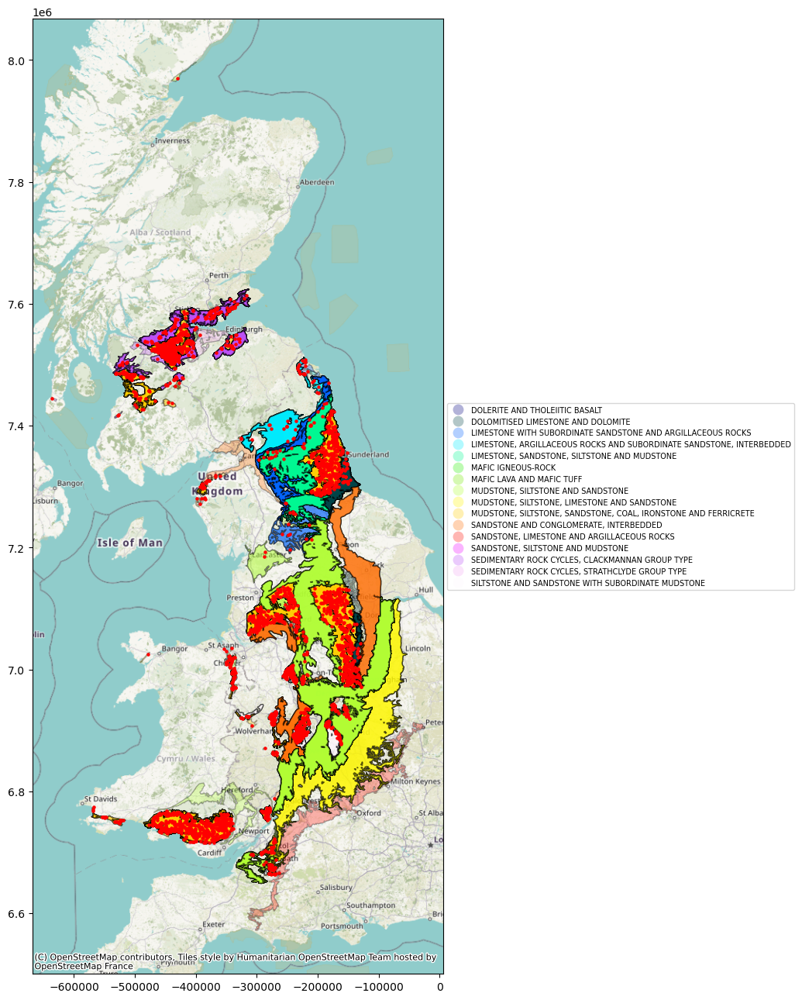

In [16]:
ax4 = joined_df.plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar", legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
cdf_wm_clipped.plot(ax=ax4, marker='o', color='red', markersize=5)
cx.add_basemap(ax4, crs='EPSG:3857')

To add another useful insight we can also create a histogram of the unique entries in our new dataframe, using the code below.

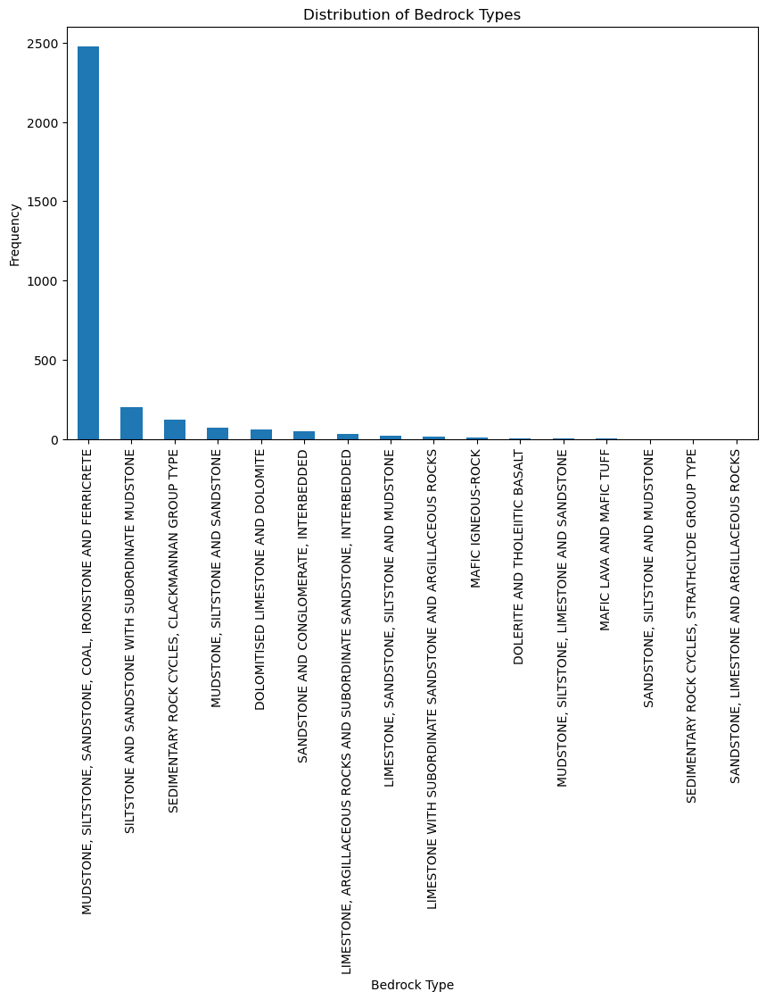

In [17]:
# Create a histogram
plt.figure(figsize=(10, 6))  # You can adjust the size of the figure
distribution.plot(kind='bar')  # 'bar' for a bar chart (histogram)
plt.title('Distribution of Bedrock Types')
plt.xlabel('Bedrock Type')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotates the x labels to make them more readable
plt.show()

<div class="alert alert-block alert-success">
<b> Exercise 2: Create a map of collieries on mudstone bedrock. <a name="Exercise2"></a>  </b> Repeat the above code demonstration but by joining a bedrock dataframe that only contains data on mudstone deposits. I have chosen the name of a new dataframe for you.
</div>

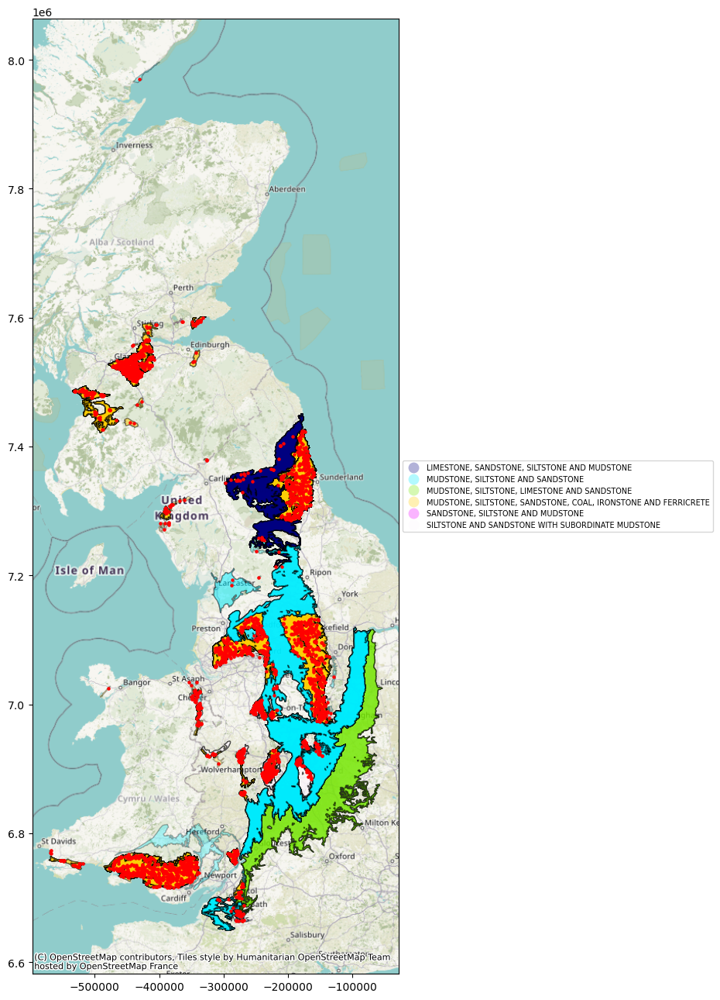

In [18]:
# -------'INSERT CODE HERE'-------
# Create a subset dataframe with entries that only include 'MUDSTONE'
gdf_wm_ex2 = gdf_wm[gdf_wm["RCS_D"].str.contains('MUDSTONE')]
# Perform spatial join
joined_df_ex2 = gpd.sjoin(gdf_wm_ex2, cdf_wm)
# Create map
ax_ex2 = joined_df_ex2[joined_df_ex2.geom_type == 'Polygon'].plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar",legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
cdf_wm.clip(joined_df_ex2).plot(ax=ax_ex2, marker='o', color='red', markersize=5)
cx.add_basemap(ax_ex2, crs='EPSG:3857')
# --------------------------------

<div class="alert alert-block alert-success">
<b> Exercise 3. Create a map of colliery location and underlying bedrock in Greater Manchester <a name="Exercise3"></a>  
</b> 

In this exercise we have been provided with a GeoJSON file that contains the shape of Greater Manchester authorities. We want to use this geometry to clip our existing dataframes on bedrock and colliery locations to create a map of Greater Manchester. I have suggested dataframe names for you in the code snippet below, but you will need to import the relevant code from the examples given above. Please remember that each dataframe should use the same Coordinate Reference System (CRS).
    
</div>

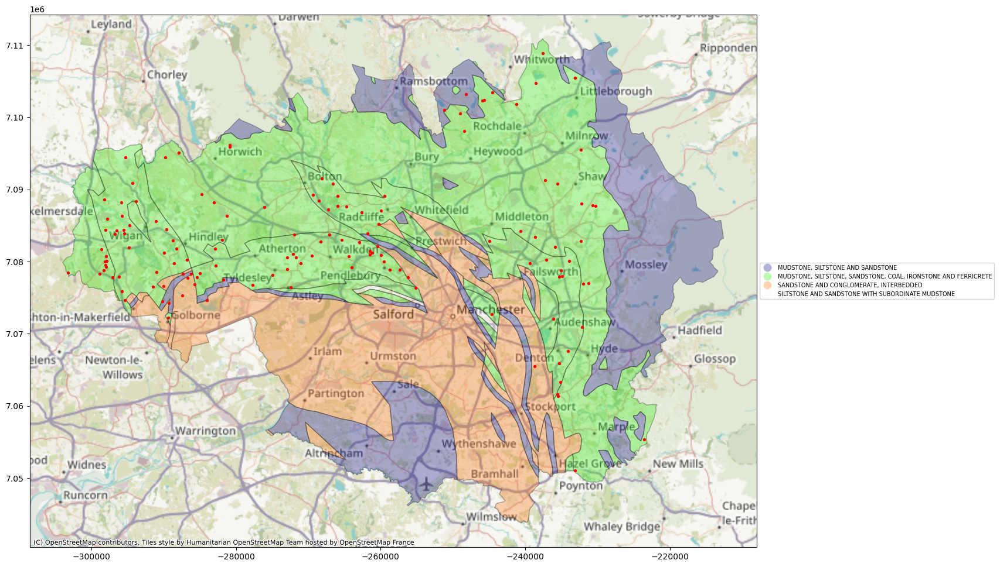

In [19]:
# -------'INSERT CODE HERE'-------
# Location of the GM authority geometries
file_GM = path+"/data/gmauthorities.geojson"
# Read the .geojson file into a new dataframe
GMdf = gpd.read_file(file_GM)
# Convert to EPSG:3857
GMdf_wm = GMdf.to_crs(epsg=3857)
# Clip the bedrock dataframe
gdf_wm_GM = gdf_wm.clip(GMdf_wm)
# Clip the colliery dataframe
cdf_wm_GM=cdf_wm.clip(GMdf_wm)
# Create a map
ax_ex3 = gdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="RCS_D", edgecolor="k", cmap="gist_ncar", legend=True, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5),"fontsize":7})
cdf_wm_GM.plot(ax=ax_ex3, marker='o', color='red', markersize=8)
#cx.add_basemap(ax3, source="basemap_GM.tif")
cx.add_basemap(ax_ex3, crs='EPSG:3857')
# --------------------------------


<div class="alert alert-block alert-success">
<b> Exercise 4. Plot the location of flood risk zones across Greater Manchester <a name="Exercise4"></a>  
</b> 

In this exercise we have been provided with another Shapefile from the [Environment Agency](https://www.data.gov.uk/dataset/cf494c44-05cd-4060-a029-35937970c9c6/flood-map-for-planning-rivers-and-sea-flood-zone-2). This contains information on areas predicted to have a 0.1% chance of flooding each year. The actual use of this data for planning is somewhat complex, but we have been tasked wth creating two maps for Greater manchester. The first map displays the total extent of the dataset, labelling areas by the predicted cause of flooding (Tidal and Fluvial). The second displays the same inforamtion but only across the Greater Manchester region.

The [different types](https://storymaps.arcgis.com/stories/863d930b86cd427883e2f09be144b679#) of flood relate to the water body which is flooding land areas:
 - Fluvial = river flooding
 - Pluvial = surface water flooding
 - Tidal = coastal flooding and storm surges


We will therefore want to use the Greater Manchester geometry to clip this data provided by the Environment Agency. I have suggested dataframe names for you in the code snippet below, but you will need to import the relevant code from the examples given above. Please remember that each dataframe should use the same Coordinate Reference System (CRS). You will also need to identify which column to use that contains information on the predicted cause.    
</div>

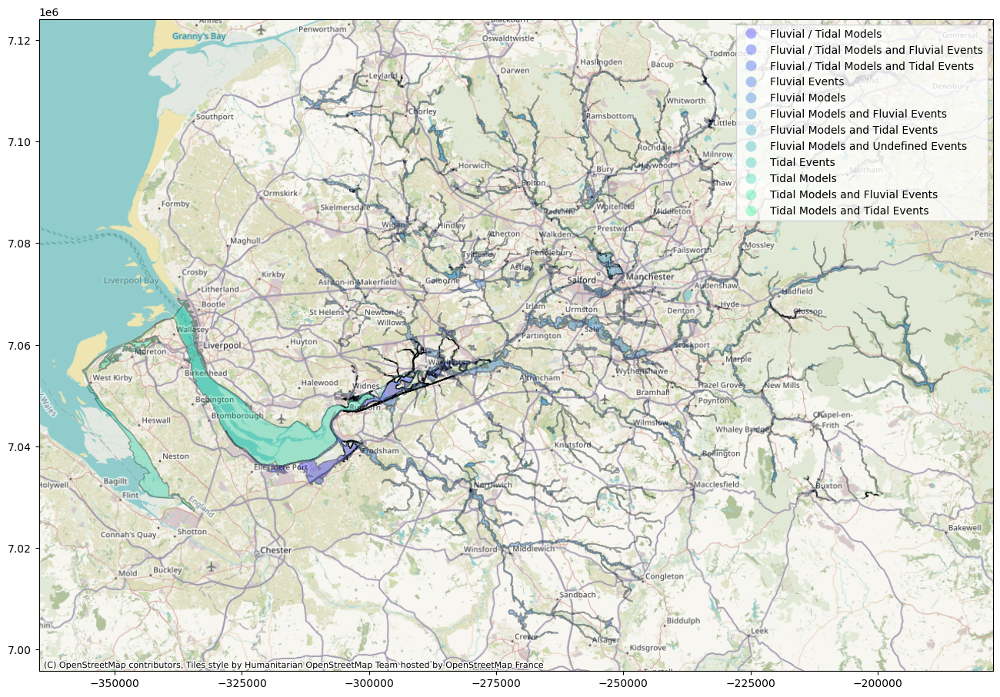

In [20]:
# Figure 1 - plot entire dataset

# -------'INSERT CODE HERE'-------
file_flood_risk = path+"/data/EA_floodrisk_level2/Environment_Agency_Flood_Zone_2.shp"
frdf = gpd.read_file(file_flood_risk)
frdf_wm = frdf.to_crs(epsg=3857)
ax_ex4 = frdf_wm.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
cx.add_basemap(ax_ex4, crs='EPSG:3857', zoom=10)
# --------------------------------

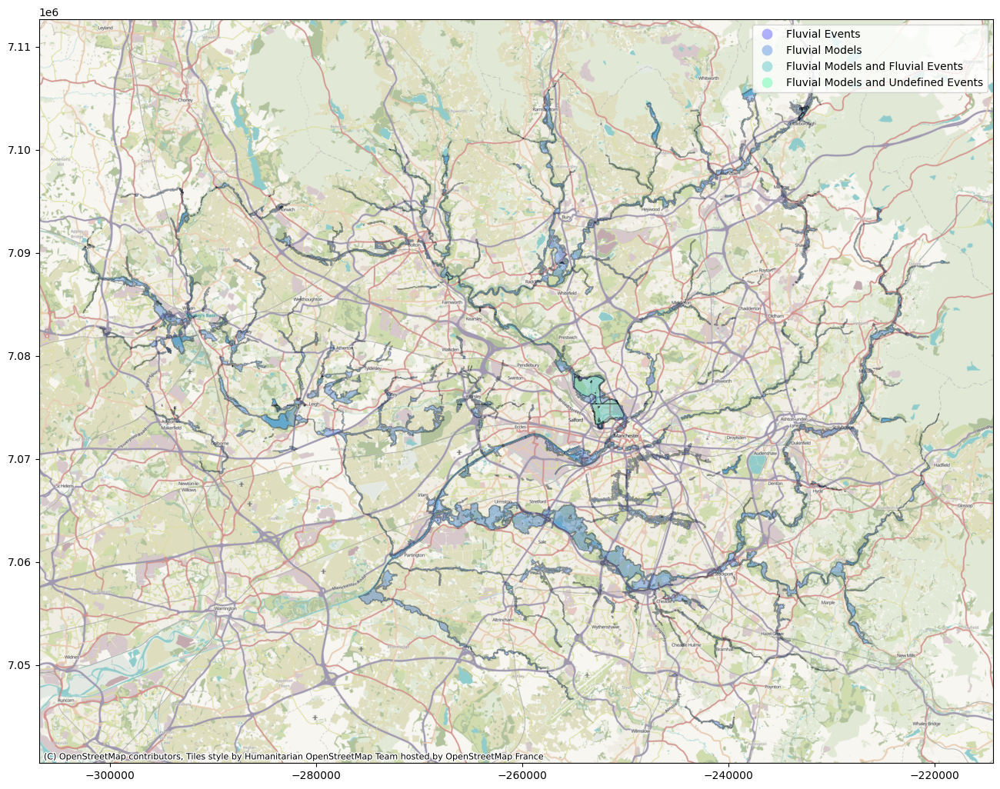

In [21]:
# Figure 2 - plot the dataset covering only the Greater Manchester region

# -------'INSERT CODE HERE'-------
frdf_wm_GM = frdf_wm.clip(GMdf_wm)
ax_ex4b = frdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
cx.add_basemap(ax_ex4b, crs='EPSG:3857', zoom=12)
# --------------------------------


# 3) Calculating distances between points and polygons  <a name="Part3">

In GeoPandas, the calculation of distances between points and polygons is carried out using the ```Shapely``` library, which GeoPandas relies on for geometric operations. This process involves measuring the shortest distance between the point geometry and the nearest part of the polygon geometry. Specifically, for each point, the distance is calculated to the closest boundary or vertex of the polygon. If a point lies inside a polygon, the distance to the polygon is considered zero.

We can see how useful this may be. For example, calculating distances to environmental hazards or inferring accesibility to green space.  GeoPandas makes this process straightforward through methods like ```.distance()```. When you call this method on a series containing point geometries and pass a polygon geometry as an argument, it returns a new Series with the distance from each point to the polygon. Similarly, if applied on a polygon GeoSeries with a point as an argument, it calculates the distances from each polygon to the point. This method is particularly useful in spatial analysis for determining proximity, defining buffer zones, or analyzing spatial relationships between different geometric entities. 

It's important to note that the distance is calculated in the coordinate system of the geometries, so for accurate distance measurements, especially over larger geographic areas, it's advisable to use a coordinate system appropriate for distance measurement, like a projected coordinate system we referred to earlier. As if by magic, we have been using a CRS (EPSG:3857) that is based on metres. The following table outlines many of the EPSG codes that use metres. 'Geographic' means the system uses latitude and longitude degrees, while 'Projected' systems use linear units like meters or feet. In geographic coordinate systems (like EPSG:4326), distances are calculated along the surface of a spheroid, making them more complex to compute, especially over large distances. In contrast, projected systems use a flat, two-dimensional plane, making distance calculations straightforward but potentially less accurate over large areas.


| EPSG Code | Reference System Name                               | Distance Type       |
|-----------|----------------------------------------------------|---------------------|
| 4326      | WGS 84                                              | Geographic          |
| 3857      | WGS 84 / Pseudo-Mercator                            | Projected (Meters)  |
| 32633     | WGS 84 / UTM zone 33N                               | Projected (Meters)  |
| 27700     | OSGB36 / British National Grid                      | Projected (Meters)  |
| 3395      | WGS 84 / World Mercator                             | Projected (Meters)  |
| 3577      | GDA94 / Australian Albers                           | Projected (Meters)  |
| 25832     | ETRS89 / UTM zone 32N                               | Projected (Meters)  |
| 26713     | NAD27 / UTM zone 13N                                | Projected (Meters)  |
| 54004     | World Sinusoidal                                    | Projected (Meters)  |
| 6933      | WGS 84 / NSIDC EASE-Grid 2.0 Global                 | Projected (Meters)  |

We can now start to build an example of how distance capabilities are useful in GeoPandas. In the following we load another ```.shp``` file that contains information on the location of [electricity substations](https://www.nationalgrid.com/stories/energy-explained/what-is-a-substation#:~:text=Substations%20contain%20equipment%20that%20help,network%20failures%20or%20power%20cuts.) from the [UK National Grid website](https://www.nationalgrid.com/electricity-transmission/network-and-infrastructure/network-route-maps). We are first going to produce a map constrained to Greater Manchester. In the following code snippet after loading the file I once again make sure this information is based on the same CRS we have been using up to this point. You may also notice I apply the function ```.centroid``` to create a new dataframe. This is solely for the purpose of wanting to use single points to represent the substation location rather than complec geometries. A preview of the new dataframe confirms we are left with point geometries.

In [22]:
file_substation = path+"/data/Substations_10Dec23/Substations.shp"
ssdf = gpd.read_file(file_substation)
ssdf_wm = ssdf.to_crs(epsg=3857)
# copy GeoDataFrame
ssdf_wm_copy = ssdf_wm.copy()
# change geometry 
ssdf_wm_copy['geometry'] = ssdf_wm_copy['geometry'].centroid
ssdf_wm_copy

,SUBSTATION,OPERATING_,ACTION_DTT,STATUS,Substation,OWNER_FLAG,GDO_GID,geometry
0,DAMC4,400kV,2020-06-09,C,DAMHEAD CREEK 400KV S/S,Y,10051888.0,POINT (66647.027 6696701.062)
1,MONF2,275kV,2020-06-09,C,MONK FRYSTON 275KV S/S,Y,10051889.0,POINT (-140956.880 7124278.600)
2,MONF2,275kV,2020-06-09,C,MONK FRYSTON 275KV S/S,Y,10051890.0,POINT (-141035.267 7124006.987)
3,ACTL8,25kV,2020-06-09,C,ACTON LANE 22KV S/S,Y,10051891.0,POINT (-28846.000 6716313.185)
4,ACTL8,25kV,2020-06-09,C,ACTON LANE 22KV S/S,Y,10051892.0,POINT (-28717.915 6716144.820)
...,...,...,...,...,...,...,...,...
542,BIGG4,400kV,2023-06-02,P,BIGGLESWADE 400KV S/S,Y,556.0,POINT (-25494.226 6814717.819)
543,UXBM1,132kV,2023-06-02,P,UXBRIDGE MOOR 132KV S/S,Y,558.0,POINT (-55779.192 6717682.110)
544,UXBM4,400kV,2023-06-02,P,UXBRIDGE MOOR 400KV S/S,Y,558.0,POINT (-55759.390 6717624.007)
545,OCKH3,0kV,2023-07-24,P,OCKER HILL 33KV S/S,Y,560.0,POINT (-226036.535 6898624.215)


In the next code snippet we clip our susbstation dataframe ```ssdf_wm_copy``` to the Greater Manchester boundaries provided by the dataframe ```GMdf_wm```. We then combine a plot of our existing floodrisk geometries and the new points that represent the location of substations; both supplemented by another basemap provided by the ```contextily``` module.

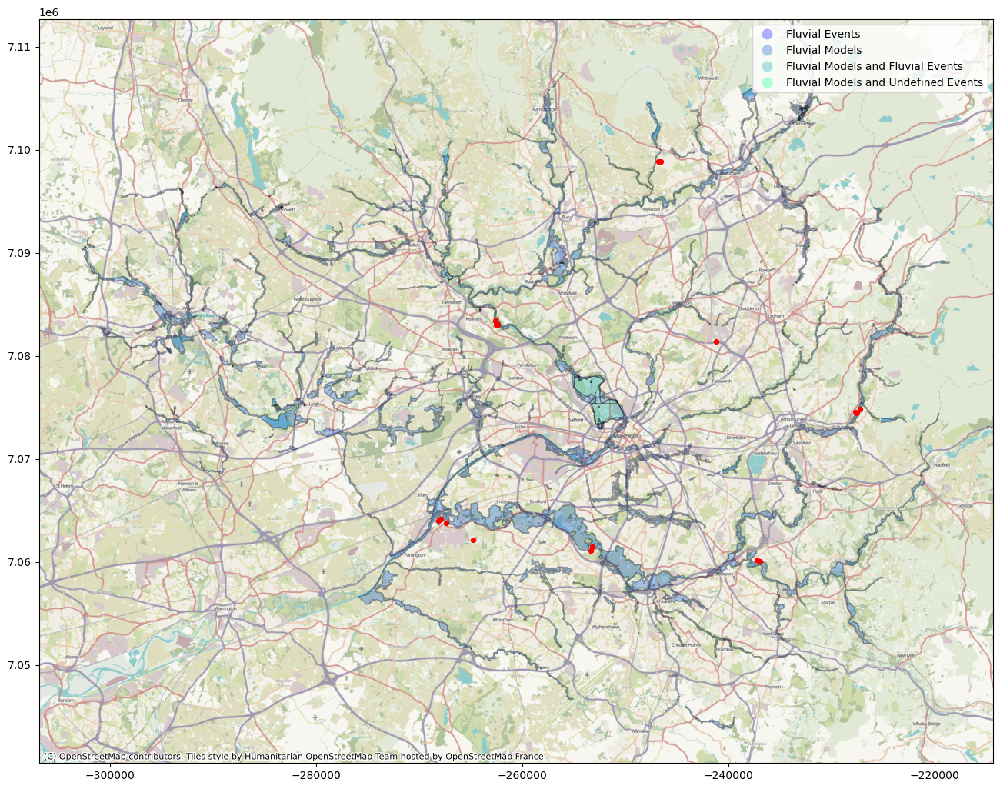

In [23]:
ssdf_wm_GM = ssdf_wm_copy.clip(GMdf_wm)
frdf_wm_GM = frdf_wm.clip(GMdf_wm)
ax_ex4c = frdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
ssdf_wm_GM.plot(ax=ax_ex4c, marker='o', color='red', markersize=18)
cx.add_basemap(ax_ex4c, crs='EPSG:3857', zoom=12)

## Adding a distance buffer

These maps already allow us to beter understand potential risk from flooding. We are inferring that substations are subject to a level of risk from flooding, which has attracted a number of [studies and government projects](https://climate-adapt.eea.europa.eu/en/metadata/case-studies/flood-defence-framework-for-national-grid-substations-in-united-kingdom) as the frequency of extreeme weather events increase. 

To take this one step further we would like to account for the distance from our substations to the predicted flooding areas. We have been working with EPSG:3857 Coordinate Reference System which is based in metres, but how can we interact with this metric? 

The first method we can use is ```.buffer```. The ```.buffer()``` method in GeoPandas is used to create a buffer zone around the geometries in a GeoSeries or GeoDataFrame. This method is particularly useful in spatial analysis, where you might want to create a zone of a specific distance around a point, line, or polygon. More specifically, in our example we can create a 1KM radius around our substation points and then plot these on the map. The .buffer() method generates a new geometric object that represents an area covered within a given distance from the original geometry. For example, if applied to a point, it will create a circle (or an approximate circle in geographic coordinate systems) around the point. If applied to a line, it creates a strip of specified width along the line.  The distance used in the .buffer() method is in the units of the GeoDataFrame's CRS. For instance, if the CRS is in latitude and longitude (like EPSG:4326), the distance is in degrees, which is not intuitive for distance measurements.

In the following code snippet we use the ```.buffer``` method on the ```ssdf_wm_GM``` dataframe which creates a new dataframe, ```risk_zone```. We pass a value of 1000 to represent 1Km. We then preview the new dataframe to confirm we have created a new set of polygons.

In [24]:
# get circle with 1 km radius 
risk_zone = ssdf_wm_GM.buffer(1000)
risk_zone

389    POLYGON ((-235993.437 7060050.402, -235998.252...
174    POLYGON ((-236252.384 7060180.038, -236257.200...
393    POLYGON ((-252393.258 7061128.836, -252398.073...
407    POLYGON ((-252264.842 7061456.955, -252269.657...
16     POLYGON ((-226575.062 7074470.583, -226579.877...
492    POLYGON ((-226749.512 7074538.453, -226754.328...
387    POLYGON ((-263837.663 7062136.511, -263842.478...
209    POLYGON ((-266396.592 7063771.965, -266401.408...
60     POLYGON ((-267126.029 7064046.204, -267130.844...
59     POLYGON ((-266946.724 7064170.013, -266951.539...
137    POLYGON ((-226234.027 7074841.808, -226238.843...
320    POLYGON ((-240256.171 7081407.501, -240260.986...
31     POLYGON ((-261428.444 7083081.174, -261433.259...
62     POLYGON ((-245623.786 7098831.565, -245628.601...
219    POLYGON ((-245782.596 7098900.465, -245787.412...
223    POLYGON ((-261551.736 7083024.974, -261556.551...
225    POLYGON ((-261648.759 7083405.206, -261653.575...
dtype: geometry

Now in the following code snippet we once again plot our flood risk geometries and substation points but now we add our new buffer geometries. In this example I specify a strange looking ```color="#ff000033"``` to create a transparent circle so we can better see the 1km distance zone. 

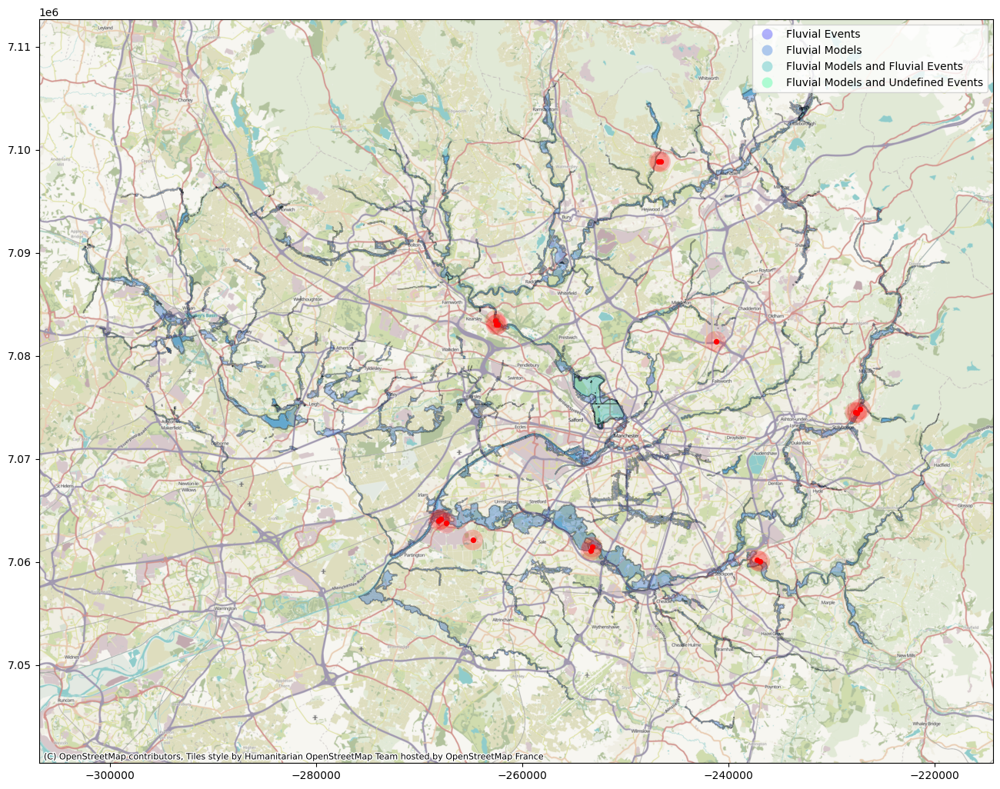

In [25]:
ax_ex4d = frdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
ssdf_wm_GM.plot(ax=ax_ex4d, marker='o', color='red', markersize=18)
risk_zone.plot(ax=ax_ex4d, color="#ff000033")
cx.add_basemap(ax_ex4d, crs='EPSG:3857', zoom=12)

## Calculating distances between points and polygons

To take this one step further we should be able to calculate and access distances between our points and flood risk polygons. This will allow us to determine which points are in the flood risk zone (distance of 0) or within a user specified tolerance. There are a number of processes taking place in the following code snippet. The aim is to iterate through each substation and calculate the distance to all flood risk areas.

<div class="alert alert-block alert-info">
    
 - Create a ```for loop``` to cycle through each substation in the dataframe ```ssdf_wm_GM```. :
 > ```for index, row in ssdf_wm_GM.iterrows():``` - the ```.iterrows()``` method of a GeoPandas dataframe returns a unique list of indices and the row content from the dataframe. 
 > We confirm the name of the current substation by printing ```row['Substation']```.
 > distances = frdf_wm_GM.geometry.distance(row.geometry) - This is the key command that returns a list of ```distances```.
 >>  ```frdf_wm_GM.geometry.distance```.  The method ```.geometry.distance(row.geometry)``` allows us to calculate the distance from the polygons held within the dataframe ```frdf_wm_GM``` with the information held in ```(row.geometry)```. 
    
At every loop we print the distances to the screen. 

</div>

In [26]:
for index, row in ssdf_wm_GM.iterrows():
    # Select one station in particular
    print(row['Substation'])
    # Measure distance from release to each station
    distances = frdf_wm_GM.geometry.distance(row.geometry)
    print(distances)

BREDBURY 275KV S/S
995     15316.356074
1230    13617.006048
1891    20862.606691
1892    19995.599135
1917    20062.968048
            ...     
7333    50787.963067
7392    49320.222082
7317    50234.510976
7318    50395.827465
7319    50398.403868
Length: 921, dtype: float64
BREDBURY 132KV S/S
995     15404.481203
1230    13572.098602
1891    20676.904964
1892    19814.480061
1917    19879.535906
            ...     
7333    50569.697445
7392    49218.967747
7317    50013.264530
7318    50175.197156
7319    50177.848613
Length: 921, dtype: float64
SOUTH MANCHESTER 275KV S/S
995     17739.808930
1230    14397.325286
1891     9706.535941
1892     9477.737272
1917     9371.364333
            ...     
7333    45964.552707
7392    52579.460351
7317    45181.359857
7318    45389.689110
7319    45398.569819
Length: 921, dtype: float64
SOUTH MANCHESTER 132KV S/S
995     17955.259888
1230    14609.895788
1891    10057.711176
1892     9824.869895
1917     9719.263450
            ...     
7333 

Rather than retain all the distances from each substation, I want to only retain the minimum distance. This way I can determine if any substations are in risk zones (distance = 0) and keep a record of the non-zero distance if they are not. In the following code snippet we initialise an empty list and, at every stage of our loop, store the minimum distance (in KM) from every substation.

In [27]:
min_distances=[]
for index, row in ssdf_wm_GM.iterrows():
    # Select one station in particular
    print(row['Substation'])
    # Measure distance from polygons to each station
    distances = frdf_wm_GM.geometry.distance(row.geometry)
    # Print the minimum distance
    print(distances.min())
    # Update min_distances list to account for the distance in km
    min_distances.append(distances.min()/1000.0)

# Add this new list into our existing GeoPandas dataframe as a new column named 'min distance to flood'
ssdf_wm_GM['min distance to flood']=min_distances

BREDBURY 275KV S/S
212.68743051913467
BREDBURY 132KV S/S
251.23069364215402
SOUTH MANCHESTER 275KV S/S
0.0
SOUTH MANCHESTER 132KV S/S
0.0
STALYBRIDGE 275KV S/S
0.0
STALYBRIDGE 25KV S/S
141.54007718982592
DAINES 400KV S/S
1588.087455581972
CARRINGTON 275KV S/S
201.78059738173124
CARRINGTON 132KV S/S
0.0
CARRINGTON 400KV S/S
0.0
STALYBRIDGE 400KV S/S
0.0
WHITEGATE 275KV S/S
1295.0350784971433
KEARSLEY 275KV S/S
136.3071588961682
ROCHDALE 132KV S/S
429.4027782829802
ROCHDALE 275KV SITE
269.9180509202209
KEARSLEY 400KV S/S
267.88594221561283
KEARSLEY 132KV GSP S/S
96.46211101706979


/Users/user/opt/anaconda3/envs/DEES_python/lib/python3.12/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


What am I going to do with this information? We can see from the preview we have some substations within the flood zone. Before I create another map Id like to change the colour of the substation depending on whether it is less than 1Km from a flood risk or not. In the code snippet below I create another column in our dataframe that holds the colour according to this criteria. Do not worry about the ```lambda`` function. This is a very efficient, but not very readable, way of performing a calculation dependent on conditions.

In [28]:
 # Create a new column for colors
ssdf_wm_GM['color'] = ssdf_wm_GM['min distance to flood'].apply(lambda x: 'aqua' if x > 1 else 'red')

/Users/user/opt/anaconda3/envs/DEES_python/lib/python3.12/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


Now we have our new colour column, in the following I recreate our mapn but now pass a color argument, ```color=ssdf_wm_GM['color']```, that will colour our substations accordingly. In the map that is created, a red point represents an area at risk (under our defintion) and an aqua point not at risk.

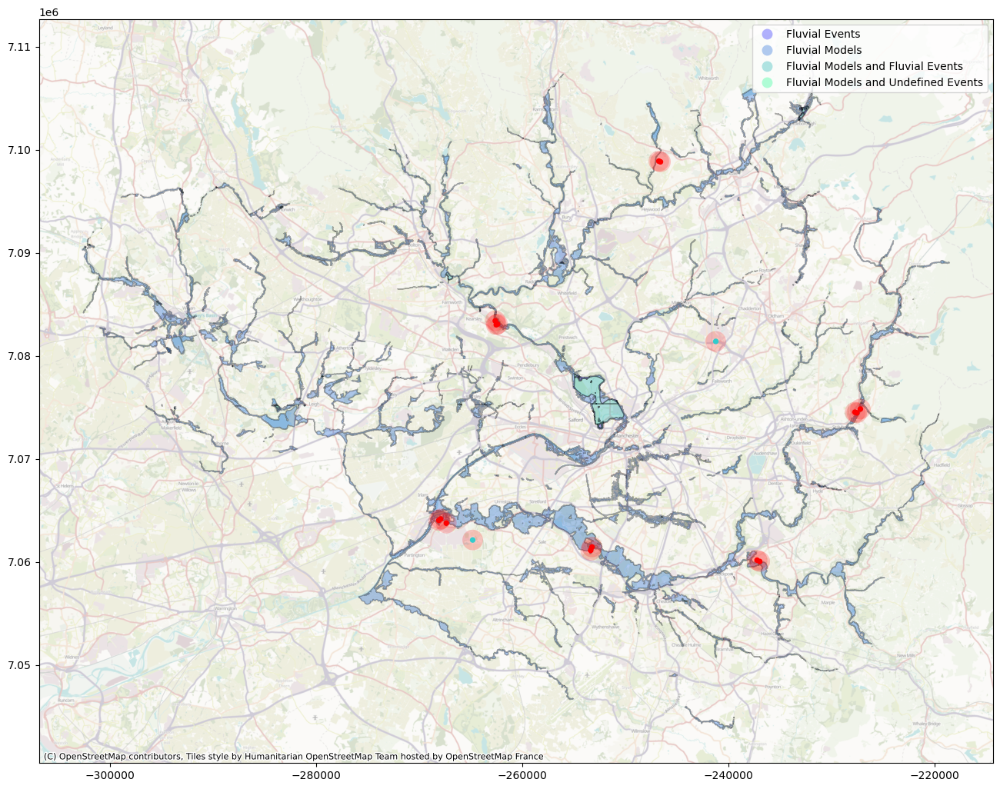

In [29]:
ax_ex4e = frdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
ssdf_wm_GM.plot(ax=ax_ex4e, marker='o', color=ssdf_wm_GM['color'], markersize=18)
risk_zone.plot(ax=ax_ex4e, color="#ff000033")
cx.add_basemap(ax_ex4e, alpha=0.5, crs='EPSG:3857', zoom=12)

One last addition before the final exercise. We have already clipped our dataframes using the geometries of the Greater Manchester region in ```GMdf_wm```. However, it would also be nice to see administrative boundaries provided within that dataframe. If we preview the dataframe we see the different metropolitan districts:

In [30]:
GMdf_wm

,LGDNAME,AREA,LGDCode,OBJECTID,NAME,AREA_CODE,DESCRIPTIO,FILE_NAME,NUMBER,NUMBER0,...,UNIT_ID,CODE,HECTARES,TYPE_CODE,DESCRIPT0,TYPE_COD0,DESCRIPT1,X,Y,geometry
0,0,0.0,0,0,Trafford District (B),MTD,Metropolitan District,TRAFFORD_DISTRICT_(B),10,55,...,18786,E08000009,10604.476,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-270251.496 7055260.349, -2702..."
1,0,0.0,0,0,Manchester District (B),MTD,Metropolitan District,MANCHESTER_DISTRICT_(B),4,70,...,18821,E08000003,11564.826,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-254514.620 7052821.304, -2544..."
2,0,0.0,0,0,Wigan District (B),MTD,Metropolitan District,WIGAN_DISTRICT_(B),15,60,...,18868,E08000010,18817.091,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-290781.985 7072493.189, -2908..."
3,0,0.0,0,0,Oldham District (B),MTD,Metropolitan District,OLDHAM_DISTRICT_(B),8,48,...,18690,E08000004,14234.507,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-223693.395 7097907.620, -2236..."
4,0,0.0,0,0,Bolton District (B),MTD,Metropolitan District,BOLTON_DISTRICT_(B),13,50,...,18832,E08000001,13979.210,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-262089.546 7080934.550, -2620..."
5,0,0.0,0,0,Rochdale District (B),MTD,Metropolitan District,ROCHDALE_DISTRICT_(B),4,44,...,18825,E08000005,15812.803,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-226077.399 7100246.328, -2260..."
6,0,0.0,0,0,Salford District (B),MTD,Metropolitan District,SALFORD_DISTRICT_(B),6,44,...,18805,E08000006,9719.732,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-274703.144 7064323.487, -2747..."
7,0,0.0,0,0,Bury District (B),MTD,Metropolitan District,BURY_DISTRICT_(B),9,38,...,18846,E08000002,9946.009,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-258854.474 7105168.935, -2588..."
8,0,0.0,0,0,Stockport District (B),MTD,Metropolitan District,STOCKPORT_DISTRICT_(B),12,50,...,18757,E08000007,12604.032,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-232970.653 7064341.363, -2329..."
9,0,0.0,0,0,Tameside District (B),MTD,Metropolitan District,TAMESIDE_DISTRICT_(B),15,44,...,18700,E08000008,10315.421,AA,CIVIL ADMINISTRATION AREA,None,None,None,None,"MULTIPOLYGON (((-232970.653 7064341.363, -2329..."


We could plot this directly using the ```.boundary.plot``` method as per the figure below.

<Axes: >

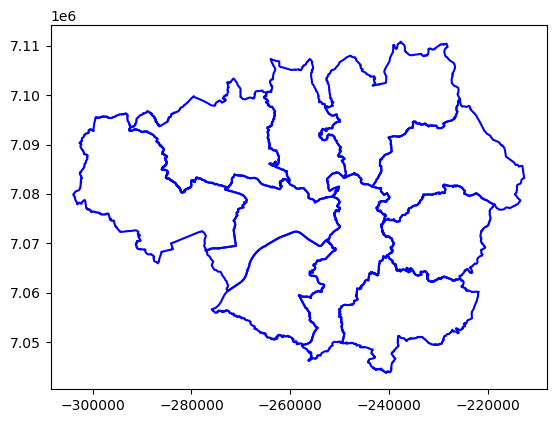

In [31]:
GMdf_wm.boundary.plot(edgecolor='blue')

However we want to add this to our risk map. To do that, we repeat this same command but attach it to the axis created for our flood risk map.

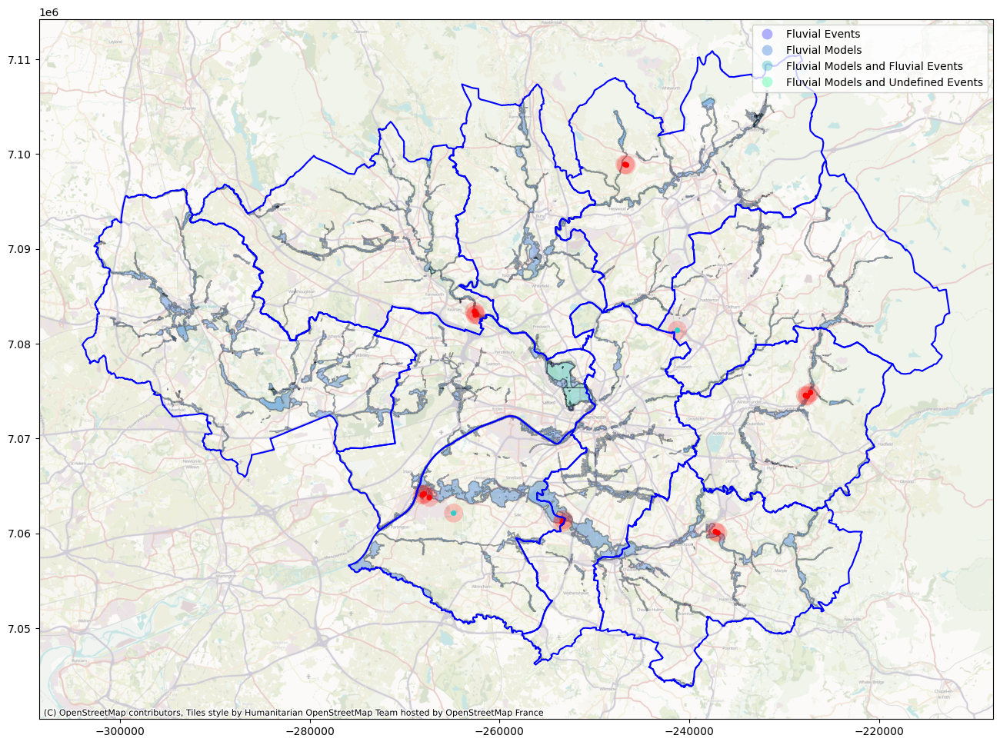

In [33]:
ax_ex4f = frdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
ssdf_wm_GM.plot(ax=ax_ex4f, marker='o', color=ssdf_wm_GM['color'], markersize=18)
risk_zone.plot(ax=ax_ex4f, color="#ff000033")
GMdf_wm.boundary.plot(ax=ax_ex4f, edgecolor='blue')
cx.add_basemap(ax_ex4f, alpha=0.5, crs='EPSG:3857', zoom=12)

<div class="alert alert-block alert-success">
<b> Exercise 5. Create a map of flooding and substation risk for the Stockport District <a name="Exercise5"></a>  
</b> 

In this exercise we want to use the polygon that represents the Stockport District in the dataframe ```GMdf_wm``` to clip our existing dataframes and produce a plot that focuses solely on this region.

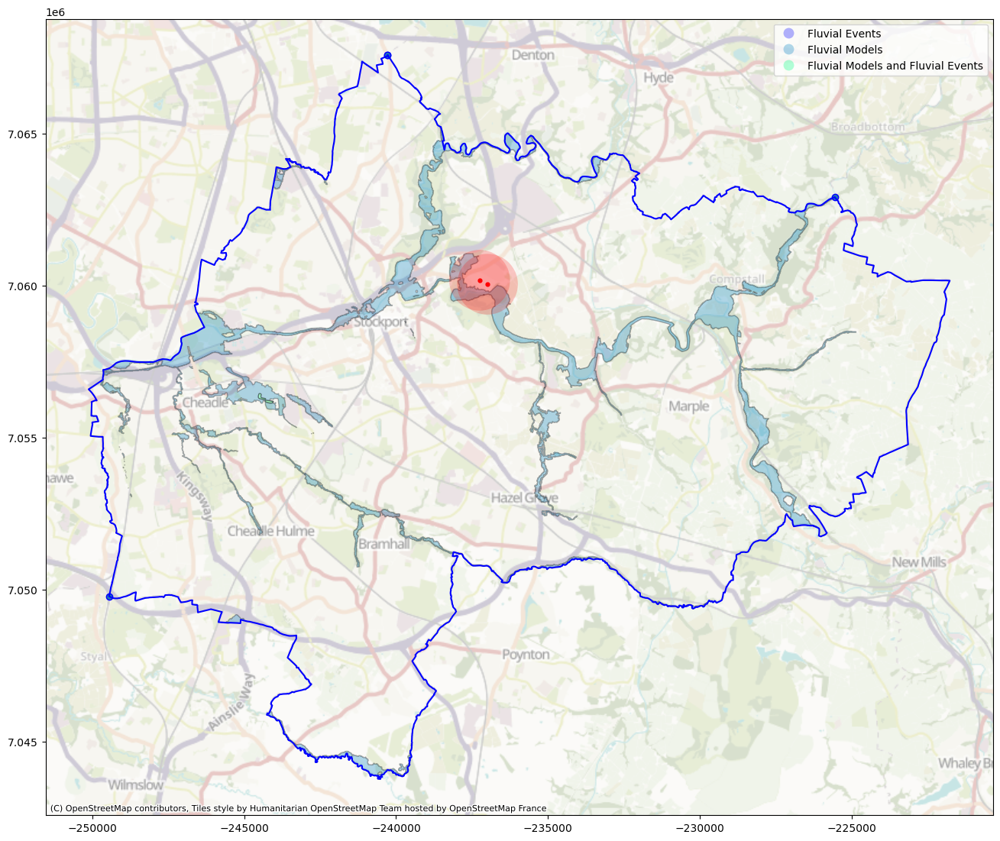

In [34]:
# -------'INSERT CODE HERE'-------
# Create new flood risk dataframe for Stockport
Stock_frdf_wm_GM = frdf_wm_GM.clip(GMdf_wm[GMdf_wm['NAME']=='Stockport District (B)'])
# Create new substation dataframe for Stockport
Stock_ssdf_wm_GM = ssdf_wm_GM.clip(GMdf_wm[GMdf_wm['NAME']=='Stockport District (B)'])
# Create new buffer zone
risk_zone = Stock_ssdf_wm_GM.buffer(1000)
# Create new map
ax_ex5 = Stock_frdf_wm_GM.plot(figsize=(16, 16), alpha=0.3, column="type", edgecolor="k", cmap="winter", legend=True)
Stock_ssdf_wm_GM.plot(ax=ax_ex5, marker='o', color='red', markersize=12)
risk_zone.plot(ax=ax_ex5, color="#ff000033")
GMdf_wm.clip(GMdf_wm[GMdf_wm['NAME']=='Stockport District (B)']).boundary.plot(ax=ax_ex5, edgecolor='blue')
cx.add_basemap(ax_ex5, alpha=0.5, crs='EPSG:3857', zoom=12)
# --------------------------------